First example of making a concave hull and trying to rotate it. there are better versions of this i believe.

In [123]:
import numpy as np
from shapely.geometry import Point
from shapely.geometry import LineString
from shapely.geometry import Polygon

# import numpy as np
# from geomath.hulls import ConcaveHull
import matplotlib.pyplot as plt
import pandas as pd

import random

# from matplotlib.patches import PathPatch
from matplotlib.path import Path
from numpy import asarray, concatenate, ones
import matplotlib.patches as patches
import matplotlib.pyplot as plt
import math

In [51]:
class ConcaveHull(object):

    def __init__(self, points, k):
        if isinstance(points, np.core.ndarray):
            self.data_set = points
        elif isinstance(points, list):
            self.data_set = np.array(points)
        else:
            raise ValueError('Please provide an [N,2] numpy array or a list of lists.')

        # Clean up duplicates
        self.data_set = np.unique(self.data_set, axis=0)

        # Create the initial index
        self.indices = np.ones(self.data_set.shape[0], dtype=bool)  # bool of a column of all 1's

        self.k = k

    @staticmethod
    def dist_pt_to_group(a, b):  # a is a (n,2) , b is (1,2) arrays
        d = np.sqrt(np.sum(np.square(np.subtract(a, b)), axis=1))
        return d

    @staticmethod
    def get_lowest_latitude_index(points):
        indices = np.argsort(points[:, 1])
        return indices[0]

    @staticmethod
    def norm_array(v):  # normalize row vectors in an array. observations are rows
        norms = np.array(np.sqrt(np.sum(np.square(v), axis=1)), ndmin=2).transpose()
        return np.divide(v, norms)

    @staticmethod
    def norm(v):  # normalize a single vector, is there an existing command?
        norms = np.array(np.sqrt(np.sum(np.square(v))))
        return v / norms

    def get_k_nearest(self, ix, k):
        """
        Calculates the k nearest point indices to the point indexed by ix
        :param ix: Index of the starting point
        :param k: Number of neighbors to consider
        :return: Array of indices into the data set array
        """
        ixs = self.indices
        # base_indices is list of linear indicies that are TRUE, ie part of dataset
        base_indices = np.arange(len(ixs))[ixs]
        distances = self.dist_pt_to_group(self.data_set[ixs, :], self.data_set[ix, :])
        sorted_indices = np.argsort(distances)

        kk = min(k, len(sorted_indices))
        k_nearest = sorted_indices[range(kk)]
        return base_indices[k_nearest]

    def clockwise_angles(self, last, ix, ixs, first):  # last needs to be the index of the previous current point
        if first == 1:
            last_norm = np.array([-1, 0], ndmin=2)
        elif first == 0:
            last_norm = self.norm(np.subtract(self.data_set[last, :], self.data_set[ix,:]))  # normalized vector pointing towards previous point
        ixs_norm = self.norm_array(np.subtract(self.data_set[ixs, :], self.data_set[ix,:]))  # normalized row vectors pointing to set of k nearest neibs
        ang = np.zeros((ixs.shape[0], 1))
        for j in range(ixs.shape[0]):
            theta = np.arccos(np.dot(last_norm, ixs_norm[j, :]))
            # ang[j,0] = theta
            z_comp = np.cross(last_norm, ixs_norm[j, :])
            # ang[j,2] = z
            if z_comp <= 0:
                ang[j, 0] = theta
            elif z_comp > 0:
                ang[j, 0] = 2 * np.pi - theta
        return np.squeeze(ang)

    def recurse_calculate(self):
        """
        Calculates the concave hull using the next value for k while reusing the distances dictionary
        :return: Concave hull
        """
        recurse = ConcaveHull(self.data_set, self.k + 1)
        if recurse.k >= self.data_set.shape[0]:
            print(" max k reached, at k={0}".format(recurse.k))
            return None
        print("k={0}".format(recurse.k))
        return recurse.calculate()

    def calculate(self):
        """
        Calculates the convex hull of the data set as an array of points
        :return: Array of points (N, 2) with the concave hull of the data set
        """
        if self.data_set.shape[0] < 3:
            return None

        if self.data_set.shape[0] == 3:
            return self.data_set

        # Make sure that k neighbors can be found
        kk = min(self.k, self.data_set.shape[0])

        first_point = self.get_lowest_latitude_index(self.data_set)
        current_point = first_point
        # last_point = current_point # not sure if this is necessary since it wont get used until after step 2

        # Note that hull and test_hull are matrices (N, 2)
        hull = np.reshape(np.array(self.data_set[first_point, :]), (1, 2))
        test_hull = hull

        # Remove the first point
        self.indices[first_point] = False

        step = 2
        stop = 2 + kk

        while ((current_point != first_point) or (step == 2)) and len(self.indices[self.indices]) > 0:  # last condition counts number of ones, points in dataset
            if step == stop:
                self.indices[first_point] = True
            # notice how get_k_nearest doesnt take the data set directly as an arg, as it is implicit that it takes self as an imput because we are inside a class:
            knn = self.get_k_nearest(current_point, kk)  # knn = [3,6,2] or [0,2,7] etc indicies into the full dataset (with no points removed)

            if step == 2:
                angles = self.clockwise_angles(1, current_point, knn, 1)
            else:
                # Calculates the headings between first_point and the knn points
                # Returns angles in the same indexing sequence as in knn
                angles = self.clockwise_angles(last_point, current_point, knn, 0)

            # Calculate the candidate indexes (largest angles first). candidates =[0,1,2]  or [2,1,0] etc if kk=3
            candidates = np.argsort(-angles)

            i = 0
            invalid_hull = True

            while invalid_hull and i < len(candidates):
                candidate = candidates[i]

                # Create a test hull to check if there are any self-intersections
                next_point = np.reshape(self.data_set[knn[candidate], :], (1, 2))
                test_hull = np.append(hull, next_point, axis=0)

                line = LineString(test_hull)
                invalid_hull = not line.is_simple  # invalid_hull will remain True for every candidate which creates a line that intersects the hull. as soon as the hull doesnt self intersect, it will become false and the loop will terminate
                i += 1

            if invalid_hull:
                print("invalid hull for all nearest neibs")
                return self.recurse_calculate()

            last_point = current_point  # record last point for clockwise angles
            current_point = knn[candidate] # candidate = 0, 1, or 2 if kk=3
            hull = test_hull

            self.indices[current_point] = False # we remove the newly found current point from the "mask" indicies so that it wont be passed to get_k_nearest (within the implicit input, self)
            step += 1

        poly = Polygon(hull)

        count = 0
        total = self.data_set.shape[0]
        for ix in range(total):
            pt = Point(self.data_set[ix, :])
            if poly.intersects(pt) or pt.within(poly):
                count += 1
            else:
                print("point not in polygon")

        if count == total:
            return hull
        else:
            return self.recurse_calculate()


In [149]:
# x = np.random.rand(1000,1)
# y = x
# print(np.ndarray.flatten(x))
xy = np.ones((1000,2))
for i in range(len(y)):
    xy[i] = xy[i] * np.random.rand(1)
print(xy)

[[0.27695668 0.27695668]
 [0.86500303 0.86500303]
 [0.9362907  0.9362907 ]
 ...
 [0.32637401 0.32637401]
 [0.92103303 0.92103303]
 [0.53613614 0.53613614]]


In [96]:
# y = sol[:, 1]
# new_y = np.empty((1000,1))
new_y = []
for i in range(len(y)):
    new_y.append(y + np.random.normal(0, .25, 1))
    
# changed = y + np.random.normal(0, .25, len(y))
# print(new_y)

# noisy_y = np.array(new_y)
print(new_y)
# sol2 = np.ndarray((len(y),1))
# for i in range(len(y)):

#     # sol2[i, 0] = sol[i, 0]
#     sol2[i, 1] = changed[i]
# #     # if i == 0:
# #     #     sol2[i, 0] = sol[i, 0]
# #     #     sol2[i, 1] = 3.5

# y = sol2[:,1]

[array([[0.91617826],
       [0.26540704],
       [0.26851806],
       [1.19366119],
       [0.55281142],
       [1.06602587],
       [0.45164059],
       [0.79586351],
       [0.89497175],
       [1.10816104],
       [1.24686391],
       [1.02776746],
       [0.3848162 ],
       [1.0610808 ],
       [0.69318414],
       [1.00002232],
       [0.49656984],
       [0.84618847],
       [0.89135641],
       [1.20389777],
       [0.48172633],
       [0.98257524],
       [0.94394485],
       [0.58455358],
       [0.59239775],
       [0.5170225 ],
       [1.15093533],
       [0.97710252],
       [1.07221493],
       [0.41399114],
       [0.51607361],
       [0.85766685],
       [0.58268031],
       [1.22917526],
       [0.91538851],
       [0.29165996],
       [0.37157191],
       [0.4749374 ],
       [0.30687747],
       [1.23050809],
       [1.01256425],
       [0.62236941],
       [1.11039525],
       [0.32520175],
       [0.54977666],
       [0.70062216],
       [1.20629137],
       [0.62

[0.4995590186798108, 0.4995590186798108]


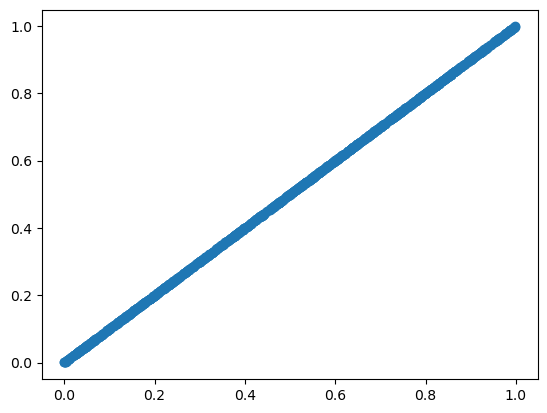

In [164]:
plt.scatter(xy[:,0], xy[:,1])
# plt.scatter(threshold_samples[:,0], threshold_samples[:,1], color = 'b')
m, n = np.polyfit(np.ndarray.flatten(xy[:,0]), np.ndarray.flatten(xy[:,1]), 1)

new_y = m * xy[:,1] + n
angle = np.arctan(m)

# plt.scatter(min(xy[:,0]), min(new_y), color='red')
# plt.scatter(max(xy[:,0]), max(new_y), color='red')
midpoint = [(min(xy[:,0])+ max(xy[:,1]))/2, (min(new_y) + max(new_y))/2]
print(midpoint)

In [124]:
def rotate(origin, point, angle):
    """
    Rotate a point counterclockwise by a given angle around a given origin.
    The angle must be in radians.
    """
    ox, oy = origin
    px, py = point

    qx = ox + math.cos(angle) * (px - ox) - math.sin(angle) * (py - oy)
    qy = oy + math.sin(angle) * (px - ox) + math.cos(angle) * (py - oy)
    return qx, qy

In [150]:
def rotateMatrix(a):
    return np.array([[np.cos(a), -np.sin(a)], [np.sin(a), np.cos(a)]])

In [178]:
newxy=(xy-[midpoint[0],midpoint[1]]) @ rotateMatrix(angle) + [midpoint[0],midpoint[1]]

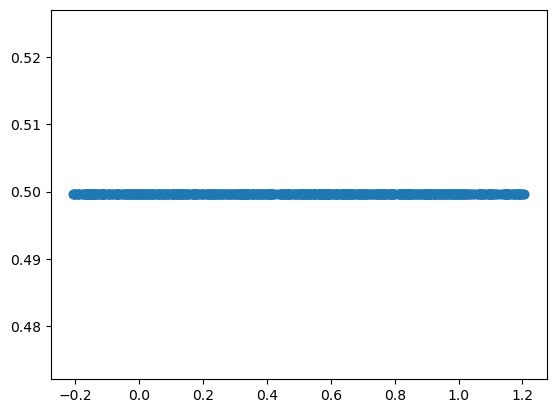

In [179]:
plt.scatter(newxy[:,0], newxy[:,1])
# plt.scatter(newxy)

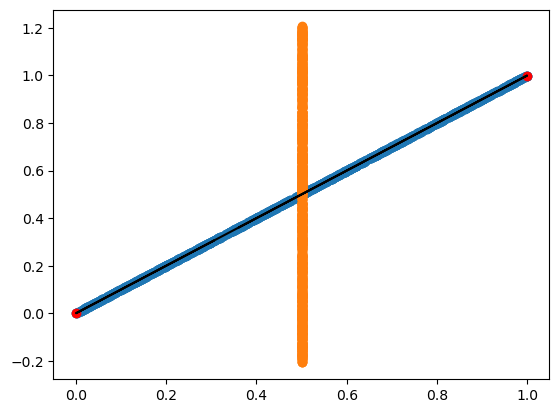

In [134]:
plt.scatter(x, x)
# plt.scatter(threshold_samples[:,0], threshold_samples[:,1], color = 'b')
m, n = np.polyfit(np.ndarray.flatten(x), np.ndarray.flatten(x), 1)

new_y = m * x + n
# print(new_y)
# m, n = np.polyfit(x, y, 1)
plt.plot(np.ndarray.flatten(x), np.ndarray.flatten(new_y), color = 'black')
angle = np.arctan(m)
# print(angle)

plt.scatter(min(x), min(new_y), color='red')
plt.scatter(max(x), max(new_y), color='red')
endpoints = 

new_points = []
for i in x:
    new_points.append(rotate([.5,.5], [i,i], angle))

newer_points = np.array(new_points)
plt.scatter(newxy[:,0], newxy[:,1])

# new_point = rotate([.5,.5], [x[0], x[0]], angle)
# print([x[0],x[0]])
# print(new_point)

# plt.plot(np.ndarray.flatten(x), np.ndarray.flatten(new_y) * angle, color = 'black')
# plt.scatter(x, new_points, angle)

# plt.scatter




In [ ]:
# y = sol[:, 1]
# changed = y + np.random.normal(0, .25, len(y))
# sol2 = np.ndarray((len(y),2))
# for i in range(len(y)):
#     sol2[i, 0] = sol[i, 0]
#     sol2[i, 1] = changed[i]
#     if i == 0:
#         sol2[i, 0] = sol[i, 0]
#         sol2[i, 1] = 3.5

# x_true = sol2[:,1]

invalid hull for all nearest neibs
k=4
invalid hull for all nearest neibs
k=5
invalid hull for all nearest neibs
k=6
invalid hull for all nearest neibs
k=7


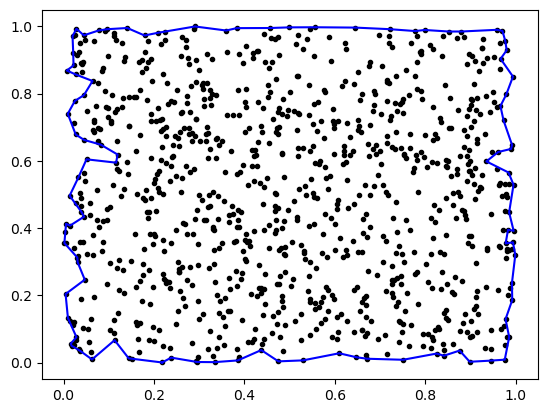

In [76]:
# dat = pd.read_csv("dat.csv")
# dat2 = np.array(dat)
dat2 = np.random.rand(1000, 2)

obj = ConcaveHull(dat2,3)
hull = obj.calculate()
plt.plot(dat2[:, 0], dat2[:, 1], 'k.')
# print(type(hull))
plt.plot(hull[:, 0], hull[:, 1], 'b-')
plt.show()

np.savetxt("hull_dat.csv", hull, delimiter=",")

In [52]:
def turning_csv(filename):

    with open(filename) as file:
        # tracts = {}
        points = []
        for line in file:
            line_list = line.split(',')
            points.append([float(line_list[0].replace('\ufeff','')), float(line_list[1].replace('\n',''))])
            # print(line_list)
    return points



invalid hull for all nearest neibs
k=4
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in polygon
point not in pol

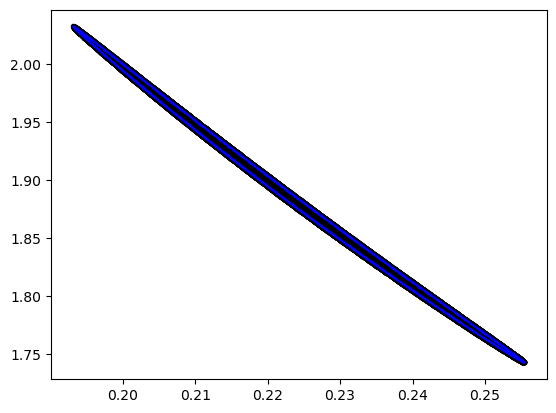

In [53]:
dat2 = np.array(turning_csv('/Users/gracerojo/Downloads/FullDataSet/high_threshold_samples.csv'))

# print(dat2)

obj = ConcaveHull(dat2,3)
hull = obj.calculate()
plt.plot(dat2[:, 0], dat2[:, 1], 'k.')
print(type(hull))
plt.plot(hull[:, 0], hull[:, 1], 'b-')
plt.show()

np.savetxt("hull_dat_try1.csv", hull, delimiter=",")


Path(array([[0.25540677, 1.74246264],
       [0.25540112, 1.74258226],
       [0.25538889, 1.7427303 ],
       ...,
       [0.25522256, 1.74285436],
       [0.25536551, 1.74248513],
       [0.25540677, 1.74246264]]), array([ 1,  2,  2, ...,  2,  2, 79], dtype=uint8))
True
[[0.25540677 1.74246264]
 [0.25540112 1.74258226]
 [0.25538889 1.7427303 ]
 ...
 [0.25522256 1.74285436]
 [0.25536551 1.74248513]
 [0.25540677 1.74246264]]
<class 'matplotlib.path.Path'>
<class 'numpy.ndarray'>
<class 'matplotlib.patches.Polygon'>
Polygon4894((0.255407, 1.74246) ...)


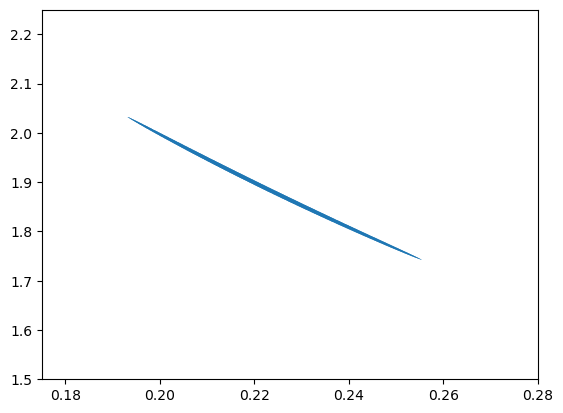

In [18]:
fig = plt.figure()
# ax.set_xlim(-.1, .6)
# ax.set_ylim(-1, 6)
ax = fig.gca()
ax.set_xlim(.175, .28)
ax.set_ylim(1.5, 2.25)
# path = turning_csv('/Users/gracerojo/Downloads/FullDataSet/high_threshold_samples.csv')

path = hull
ax.add_patch(patches.Polygon(path))

polygon_try1 = patches.Polygon(path)


print(patches.Polygon(path).get_path())
print(patches.Polygon(path).get_closed())
print(patches.Polygon(path).get_xy())

print(type(patches.Polygon(path).get_path()))
# print(type(patches.Polygon(path).get_closed())
print(type(patches.Polygon(path).get_xy()))

print(type(ax.add_patch(patches.Polygon(path))))

print(patches.Polygon(path))
# fig.savefig("patch2.png")

# np.savetxt("polygon_path", patches.Polygon(path).get_path())
np.savetxt("polygon_vertices", patches.Polygon(path).get_xy(), delimiter=",")

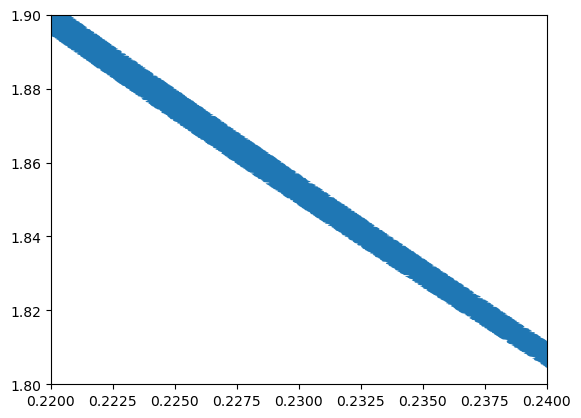

In [12]:
fig = plt.figure()
# ax.set_xlim(-.1, .6)
# ax.set_ylim(-1, 6)
ax = fig.gca()
ax.set_xlim(.22, .24)
ax.set_ylim(1.8, 1.9)
path = hull
ax.add_patch(patches.Polygon(path))

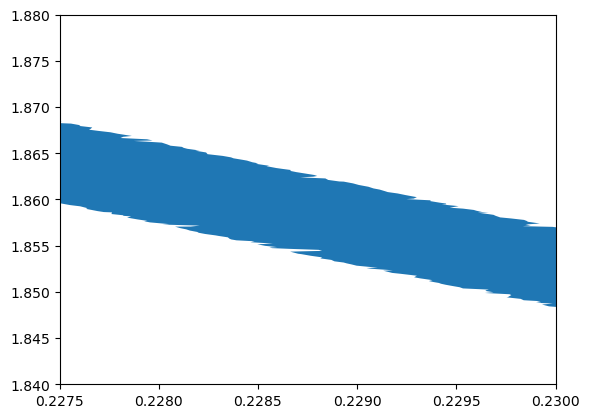

In [13]:
fig = plt.figure()
# ax.set_xlim(-.1, .6)
# ax.set_ylim(-1, 6)
ax = fig.gca()
ax.set_xlim(.2275, .23)
ax.set_ylim(1.84, 1.88)
path = hull
ax.add_patch(patches.Polygon(path))


In [26]:
def bounds(hull_NOT_polygon):
    hull = hull_NOT_polygon
    minx, miny, maxx, maxy = min(hull[:,0]), min(hull[:,1]), max(hull[:,0]), max(hull[:,1])
    return minx, miny, maxx, maxy


In [27]:
print(bounds(hull))

(0.193163017, 1.742462639, 0.25540677, 2.032276752)


In [67]:
x = 0.25540677-0.193163017
y = 2.032276752 - 1.742462639

print(x*y)


0.018039118065486096


In [73]:
def generate_random(number, hull):
    points = []
    polygon = patches.Polygon(hull)
    polygon2 = Polygon(hull)
    # minx, miny, maxx, maxy = polygon.bounds
    minx, miny, maxx, maxy = bounds(hull)
    while len(points) < number:
        pnt = Point(random.uniform(minx, maxx), random.uniform(miny, maxy))
        if polygon.contains(pnt):
            # points.append(pnt)
            points.append([pnt.x, pnt.y])
    list_points = np.array(points)
    # coords = ((minx, miny), (minx, maxy), (maxx, maxy), (maxx, miny), (minx, miny))
    # polygon2 = Polygon(coords)

    area = polygon2.area
    return list_points, area

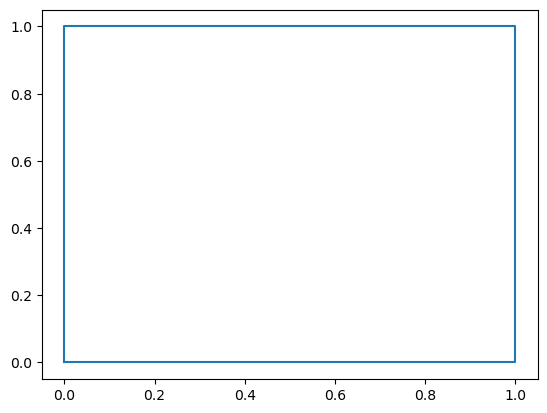

In [68]:
coords = ((0., 0.), (0., 1.), (1., 1.), (1., 0.), (0., 0.))
coords = 
polygon = Polygon(coords)
polygon.area
plt.plot(*polygon.exterior.xy)

In [74]:
rand_points_poly = generate_random(1000, hull)
# print(type(rand_points_poly[0]))
print(rand_points_poly)

(array([[0.23980271, 1.76406624],
       [0.19492734, 1.95803991],
       [0.22988799, 2.00924552],
       ...,
       [0.25357875, 1.97932954],
       [0.242058  , 1.79590127],
       [0.217962  , 1.7984099 ]]), 0.0004235325666811547)


area of polygon: 0.0004235325666811547
area of bounds: 0.018039118065486096

In [43]:
list_points = []
for point in rand_points_poly:
    list_points.append([point.x, point.y])
print(np.array(list_points))

[[0.24757313 1.8218429 ]
 [0.24100588 1.78836715]
 [0.22232252 1.84738789]
 ...
 [0.22167772 1.99024661]
 [0.23798035 1.96502073]
 [0.25307336 1.94275028]]
